In [81]:
import fingerprint
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [82]:
def To2DArr(img):
    im = np.zeros((len(img), len(img[0])), dtype=float)

    for r in range(len(img)):
        for c in range(len(img[r])):
            im[r][c] = np.mean(img[r][c])/255
    
    return im

In [83]:
img = cv2.imread("images/print1.png", cv2.IMREAD_ANYCOLOR)
im = To2DArr(img) # shape: (620, 424, 3)

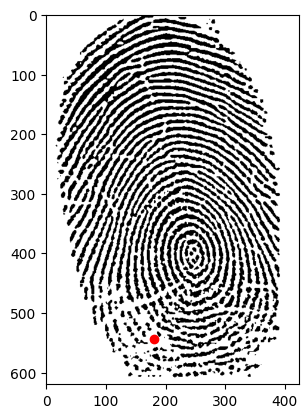

In [84]:
# Binarizing finger print image
BnW_image = fingerprint.BinarizeFingerprint("images/print1.png", method='Pixel Blocks', blockSize=15)

plt.imshow(BnW_image, cmap='gray')
plt.scatter(180,543, c='r') # looking for a center for radial filtration manually
plt.show()

In [86]:
# Trying another binarize method
from gtda.images import Binarizer

binarizer = Binarizer(threshold=.96)
im_binarized = binarizer.fit_transform(np.array([im]))

In [87]:
binarizer.plot(im_binarized)

In [128]:
# Height filtration
from gtda.images import HeightFiltration

# choose one
#binary_image = im_binarized
binary_image = np.array([BnW_image])

direction_list = [[1, 0], [1, 1], [0, 1], [-1, 1], [-1, 0], [-1, -1], [0, -1], [1, -1]]
height_filtration0 = HeightFiltration(np.array(direction_list[0]))
height_filtration1 = HeightFiltration(np.array(direction_list[1]))
height_filtration2 = HeightFiltration(np.array(direction_list[2]))
height_filtration3 = HeightFiltration(np.array(direction_list[3]))
height_filtration4 = HeightFiltration(np.array(direction_list[4]))
height_filtration5 = HeightFiltration(np.array(direction_list[5]))
height_filtration6 = HeightFiltration(np.array(direction_list[6]))
height_filtration7 = HeightFiltration(np.array(direction_list[7]))

im_height0 = height_filtration0.fit_transform(BnW_image)
im_height1 = height_filtration1.fit_transform(BnW_image)
im_height2 = height_filtration2.fit_transform(BnW_image)
im_height3 = height_filtration3.fit_transform(BnW_image)
im_height4 = height_filtration4.fit_transform(BnW_image)
im_height5 = height_filtration5.fit_transform(BnW_image)
im_height6 = height_filtration6.fit_transform(BnW_image)
im_height7 = height_filtration7.fit_transform(BnW_image)

In [142]:
height_filtration7.plot(im_height7, colorscale='jet')

In [129]:
# Calculate persistence diagrams for height filtrations of all 8 directions
from gtda.homology import CubicalPersistence

cubical_persistence = CubicalPersistence()
im_cubical = cubical_persistence.fit_transform(im_height0)
cubical_persistence.plot(im_cubical) # [1, 0]

In [130]:
im_cubical = cubical_persistence.fit_transform(im_height1)
cubical_persistence.plot(im_cubical) # [1, 1]

In [131]:
im_cubical = cubical_persistence.fit_transform(im_height2)
cubical_persistence.plot(im_cubical) # [0, 1]

In [132]:
im_cubical = cubical_persistence.fit_transform(im_height3)
cubical_persistence.plot(im_cubical) #[-1, 1]

In [133]:
im_cubical = cubical_persistence.fit_transform(im_height4)
cubical_persistence.plot(im_cubical) # [-1, 0]

In [134]:
im_cubical = cubical_persistence.fit_transform(im_height5)
cubical_persistence.plot(im_cubical) # [-1, -1]

In [135]:
im_cubical = cubical_persistence.fit_transform(im_height6)
cubical_persistence.plot(im_cubical) # [0, -1]

In [136]:
im_cubical = cubical_persistence.fit_transform(im_height7)
cubical_persistence.plot(im_cubical) # [1, -1]

In [150]:
# Density filtrations with different radius values
from gtda.images import DensityFiltration

density_filtration1 = DensityFiltration(radius=1.)
im_density1 = density_filtration1.fit_transform(im_binarized)

density_filtration1.plot(im_density1, colorscale='jet')

In [161]:
density_filtration3 = DensityFiltration(radius=3.)
#im_density3 = density_filtration3.fit_transform(im_binarized)
im_density3 = density_filtration3.fit_transform(np.array([BnW_image]))

density_filtration3.plot(im_density3, colorscale='jet')

In [151]:
density_filtration5 = DensityFiltration(radius=5.)
im_density5 = density_filtration5.fit_transform(im_binarized)

density_filtration5.plot(im_density5, colorscale='jet')

In [153]:
density_filtration7 = DensityFiltration(radius=7.)
im_density7 = density_filtration7.fit_transform(im_binarized)

density_filtration10.plot(im_density7, colorscale='jet')

In [152]:
density_filtration10 = DensityFiltration(radius=10.)
im_density10 = density_filtration10.fit_transform(im_binarized)

density_filtration10.plot(im_density10, colorscale='jet')

In [149]:
im_cubical = cubical_persistence.fit_transform(im_density1)
cubical_persistence.plot(im_cubical)

In [162]:
im_cubical = cubical_persistence.fit_transform(im_density3)
cubical_persistence.plot(im_cubical)

In [156]:
im_cubical = cubical_persistence.fit_transform(im_density5)
cubical_persistence.plot(im_cubical)

In [157]:
im_cubical = cubical_persistence.fit_transform(im_density7)
cubical_persistence.plot(im_cubical)

In [158]:
im_cubical = cubical_persistence.fit_transform(im_density10)
cubical_persistence.plot(im_cubical)